In [1]:

%load_ext autoreload
%autoreload 2

import sys
import os
sys.path.append('../')

# Graph imports
import src.graph as graph
import src.logit_estimator as estimator
import src.utils as utils
import src.model_selection as model_selection
import src.gic as gic
import src.param_estimator as pe
import src.graph as graph
import src.model_selection as ms

# usual imports
import matplotlib.pyplot as plt
import math
import numpy as np
import pandas as pd
import seaborn as sns
import gc
import random
import networkx as nx

from IPython.display import display
from pyvis.network import Network

import pickle
import os

np.random.seed(42)

In [2]:
datasets = f'../data/connectomes/'
connectomes = os.listdir(datasets)

In [3]:
for i in range(len(connectomes)):
    break
    real_graph = nx.read_graphml(datasets + connectomes[i])
    print(connectomes[i])
    print("\tNodes:", real_graph.number_of_nodes())
    print("\tEdges:", real_graph.number_of_edges())
    print()


# Plot and Spectrum and model selection for different connectomes

In [4]:
def get_logit_graph(real_graph, d, n_iteration, warm_up, patience):
   # Ensure real_graph is a NumPy array
   if isinstance(real_graph, nx.Graph):
       real_graph = nx.to_numpy_array(real_graph)
   
   # Estimation
   est = estimator.LogitRegEstimator(real_graph, d=d)
   features, labels = est.get_features_labels()
   result, params, pvalue = est.estimate_parameters(l1_wt=1, alpha=0, features=features, labels=labels)
   sigma = params[0]

   # Generation
   n = real_graph.shape[0]

   # TODO: improve the estimation of d
   d = 0

   params_dict = {
      "n": n,
      "d": d,
      "sigma": sigma,
      "n_iteration": n_iteration,
      "warm_up": warm_up
   }

   graph_model = graph.GraphModel(n=n, d=d, sigma=sigma)
   graphs, spec, spectrum_diffs, best_iteration = graph_model.populate_edges_spectrum(
       warm_up=warm_up,
       max_iterations=n_iteration,
       patience=100,  # You may want to adjust this value
       real_graph=real_graph
   )
   # Use the best graph found
   best_graph = graphs[best_iteration]
   # Calculate GIC for the best graph
   best_graph_nx = nx.from_numpy_array(best_graph)
   gic_value = gic.GraphInformationCriterion(
       graph=nx.from_numpy_array(real_graph),
       log_graph=best_graph_nx,
       model='LG'
   ).calculate_gic()
   
   gic_values = [gic_value]
   return best_graph, sigma, gic_values, spectrum_diffs, best_iteration

In [5]:
def clean_and_convert(param):
    cleaned_param = ''.join(c for c in param if c.isdigit() or c == '.' or c == '-')
    return float(cleaned_param)

# Analysing one connectome per time

In [9]:
i = 2
print(connectomes[i])

rattus.norvegicus_brain_1.graphml


In [10]:
real_graph = nx.read_graphml(datasets + connectomes[i])
real_graph = nx.to_numpy_array(real_graph)
logit_graph, sigma, gic_values, spectrum_diffs, best_iteration = get_logit_graph(real_graph=nx.from_numpy_array(real_graph),
                                                                                 d=0,
                                                                                 warm_up=10000,
                                                                                 n_iteration=20000,
                                                                                 patience=100)

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.718     
Date:               2024-08-27 16:44 AIC:              33848.4629
No. Observations:   126253           BIC:              33877.7010
Df Model:           2                Log-Likelihood:   -16921.   
Df Residuals:       126250           LL-Null:          -59974.   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     20.0000          Scale:            1.0000    
-------------------------------------------------------------------
         Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const   -6.5839     0.0394   -167.0025   0.0000   -6.6612   -6.5066
x1       0.0117     0.0001    145.9805   0.0000    0.0115    0.0118
x2       0.0119     0.0001    136.0039   0.0000    0.0117    0.0121

iteration: 0
	 Spectrum

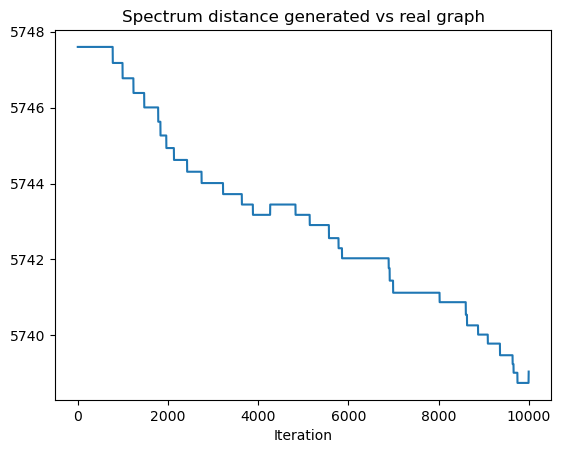

In [11]:
# Showing the spectrum evolutio
plt.figure()
plt.plot(spectrum_diffs)
plt.title('Spectrum distance generated vs real graph')
plt.xlabel('Iteration')
plt.show()

In [12]:

selector = ms.GraphModelSelection(graph=nx.from_numpy_array(real_graph),
                                log_graph=nx.from_numpy_array(logit_graph),
                                log_params=sigma,
                                #models=["ER", "WS", "GRG", "BA", "KR", "LG"],
                                models=["ER", "WS", "GRG", "BA", "LG"],
                                parameters=[ {'lo': 0.01, 'hi': 1}, # ER
                                            {'lo': 0.01, 'hi': 1}, # WS k=8
                                            {'lo': 1, 'hi': 3},    # GRG
                                            {'lo': 1, 'hi': 5},    # BA
                                            #{'lo': 1, 'hi': 3},    # KR
                                            ]
                                )


result = selector.select_model()
result_dict = {item['model']: {'param': clean_and_convert(item['param']), 'GIC': item['GIC']} for item in result['estimates']}
min_gic_key = min(result_dict, key=lambda k: result_dict[k]['GIC']) # Get best fit
model_names = result_dict.keys() 

testing the selected model for ER
Model: ER, Parameters: {'lo': 0.01, 'hi': 1}
model function <function GraphModelSelection.model_function.<locals>.<lambda> at 0x2a48d32e0>

ER result:  {'param': 0.14, 'gic': 0.07187453567210267}

testing the selected model for WS
Model: WS, Parameters: {'lo': 0.01, 'hi': 1}
model function <function GraphModelSelection.model_function.<locals>.<lambda> at 0x2a2aefe20>

WS result:  {'param': 0.06, 'gic': 0.6361449549573948}

testing the selected model for GRG
Model: GRG, Parameters: {'lo': 1, 'hi': 3}
model function <function GraphModelSelection.model_function.<locals>.<lambda> at 0x2a4643d80>

GRG result:  {'param': 1.02, 'gic': 1.2557600369181783}

testing the selected model for BA
Model: BA, Parameters: {'lo': 1, 'hi': 5}
model function <function GraphModelSelection.model_function.<locals>.<lambda> at 0x2a2aec180>

BA result:  {'param': 1.5200000000000005, 'gic': 0.7515955028191565}

testing the selected model for LG
gic module :  <class 'networkx.cla

In [15]:
def plot_graphs_in_matrix(sim_graphs_dict, result_dict, global_title, save_path=None):
    # Determine the size of the grid
    num_graphs = len(sim_graphs_dict)
    cols = 4  # Or another number that suits your display
    rows = math.ceil(num_graphs / cols)

    # Create a figure with subplots
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
    axes = axes.flatten()  # Flatten the axes array for easy iteration

    for ax, (name, G) in zip(axes, sim_graphs_dict.items()):
        # Use a layout
        pos = nx.kamada_kawai_layout(G)

        # Draw nodes with a node color based on degree
        node_color = [G.degree(v) for v in G]
        #node_size = [G.degree(v) * 10 for v in G]  # Adjust node size based on degree
        if name == 'GRG':
            scale_factor = 0.1  # Adjust this factor as needed to reduce the size suitably
            node_size = [G.degree(v) * scale_factor for v in G]
        else:
            scale_factor = 1.5  # Adjust this factor as needed to reduce the size suitably
            node_size = [G.degree(v) * scale_factor for v in G]

        nx.draw_networkx_nodes(G, pos, node_color=node_color, node_size=node_size, cmap=plt.cm.viridis, ax=ax)

        # Draw edges with transparency
        nx.draw_networkx_edges(G, pos, alpha=0.5, ax=ax)

        # Set plot details for each subplot
        if name!='Real':
            ax.set_title(f'{name} Graph, GIC: {result_dict[name]["GIC"]:.2f}')
            ax.axis('off')  # Turn off the axis
        else:
            ax.set_title(f'{name} Graph')
            ax.axis('off')  # Turn off the axis

    # Hide any unused axes if the number of graphs is less than rows*cols
    for i in range(len(sim_graphs_dict), len(axes)):
        axes[i].set_visible(False)

    fig.suptitle(global_title, fontsize=16, fontweight='bold')

    # Adjust layout
    plt.tight_layout()

    if save_path:
        fig.savefig(save_path, bbox_inches='tight')

    plt.show()
    return fig

In [16]:
sim_graphs_dict = {}
for model in model_names:
    if model!='LG':
        func = selector.model_function(model_name=model)
        graph_sim = func(real_graph.shape[0], float(result_dict[model]['param']))
        sim_graphs_dict[model] = graph_sim
    elif model=='LG':
        sim_graphs_dict[model] = nx.from_numpy_array(logit_graph)

sim_graphs_dict['Real'] = nx.from_numpy_array(real_graph)
#save_path=f'./imgs_connectomes/{connectomes[i]}.png'
save_path = None
fig = plot_graphs_in_matrix(sim_graphs_dict,
                            result_dict,
                            global_title=f'./{connectomes[i]}, best fit {min_gic_key}',
                            save_path=save_path)

## Auto runs for multiple datasets

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.155     
Date:               2024-07-11 21:01 AIC:              745.0726  
No. Observations:   1225             BIC:              760.4047  
Df Model:           2                Log-Likelihood:   -369.54   
Df Residuals:       1222             LL-Null:          -437.39   
Converged:          1.0000           LLR p-value:      3.4081e-30
No. Iterations:     11.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -2.9218     0.1393   -20.9761   0.0000   -3.1948   -2.6488
x1        0.0210     0.0025     8.4585   0.0000    0.0161    0.0259
x2        0.0437     0.0059     7.3947   0.0000    0.0321    0.0553

iteration: 0
iteration:

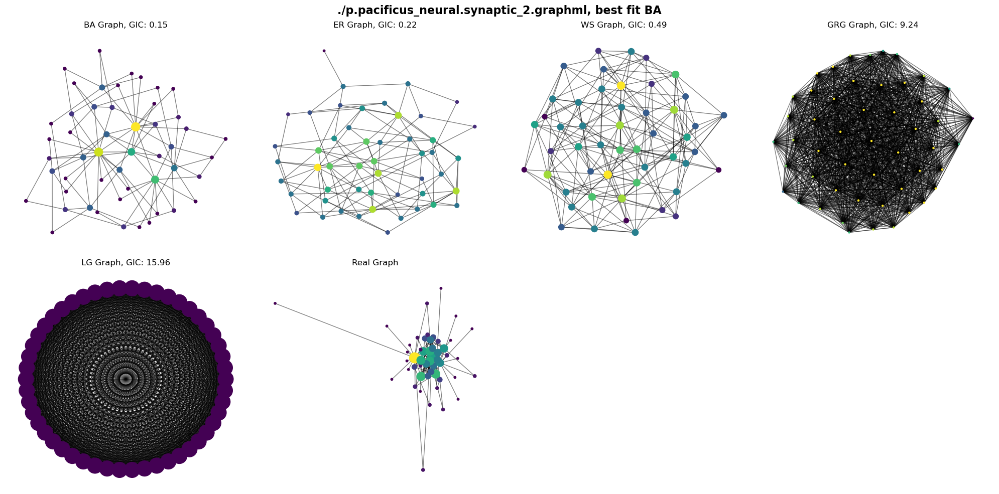

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.039     
Date:               2024-07-11 21:01 AIC:              5060.3935 
No. Observations:   4095             BIC:              5079.3461 
Df Model:           2                Log-Likelihood:   -2527.2   
Df Residuals:       4092             LL-Null:          -2630.8   
Converged:          1.0000           LLR p-value:      1.0442e-45
No. Iterations:     14.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -2.8269     0.1684   -16.7846   0.0000   -3.1570   -2.4968
x1        0.0353     0.0051     6.9463   0.0000    0.0253    0.0453
x2        0.0654     0.0057    11.5752   0.0000    0.0543    0.0765

iteration: 0
iteration:

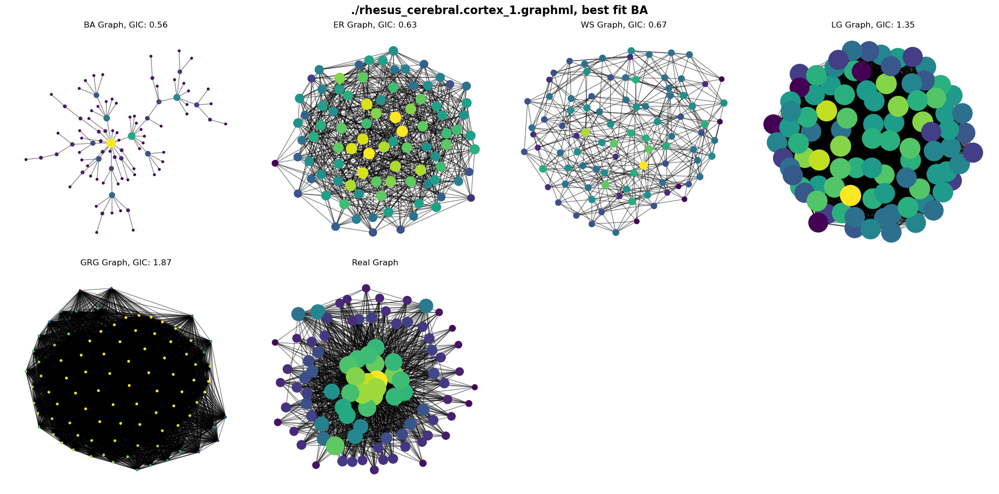

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.206     
Date:               2024-07-11 21:01 AIC:              95295.4301
No. Observations:   126253           BIC:              95324.6682
Df Model:           2                Log-Likelihood:   -47645.   
Df Residuals:       126250           LL-Null:          -59974.   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     18.0000          Scale:            1.0000    
-------------------------------------------------------------------
         Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const   -3.6090     0.0209   -172.9344   0.0000   -3.6499   -3.5681
x1       0.0120     0.0001     87.4042   0.0000    0.0118    0.0123
x2       0.0086     0.0001     79.0788   0.0000    0.0084    0.0088

iteration: 0
iteration:

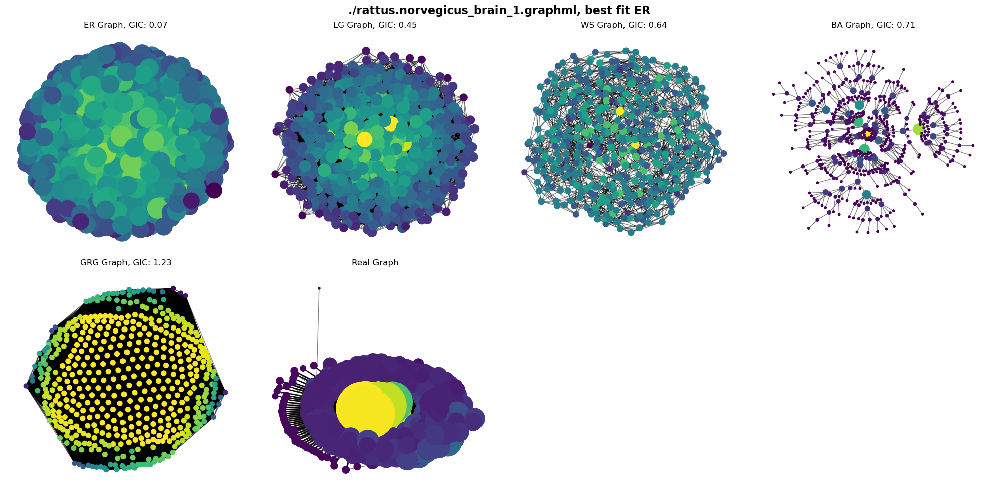

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.147     
Date:               2024-07-11 21:04 AIC:              2306.0632 
No. Observations:   2080             BIC:              2322.9835 
Df Model:           2                Log-Likelihood:   -1150.0   
Df Residuals:       2077             LL-Null:          -1347.9   
Converged:          1.0000           LLR p-value:      1.1400e-86
No. Iterations:     14.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -3.2791     0.1657   -19.7865   0.0000   -3.6039   -2.9543
x1        0.0840     0.0057    14.8092   0.0000    0.0729    0.0951
x2        0.0635     0.0053    12.0782   0.0000    0.0532    0.0738

iteration: 0
iteration:

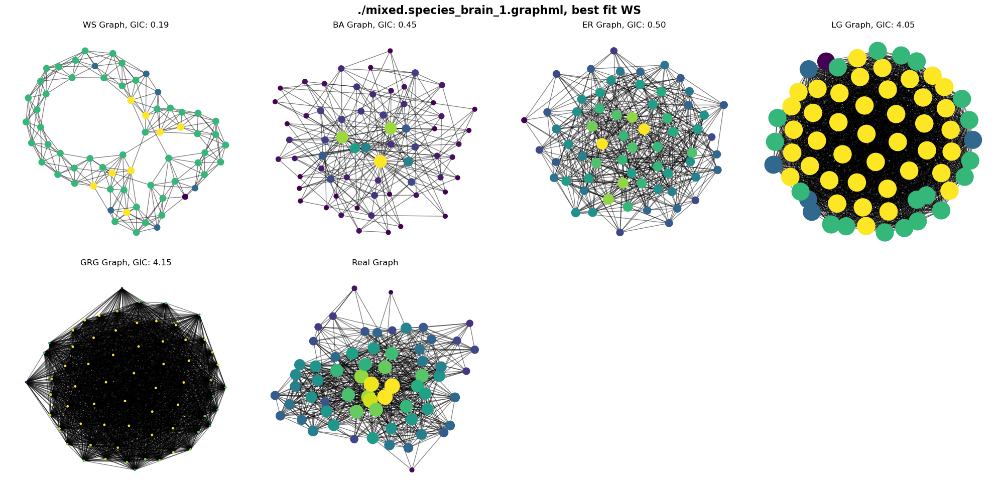

                          Results: Logit
Model:              Logit            Method:           MLE        
Dependent Variable: y                Pseudo R-squared: 0.356      
Date:               2024-07-11 21:04 AIC:              1514.6152  
No. Observations:   18915            BIC:              1538.1583  
Df Model:           2                Log-Likelihood:   -754.31    
Df Residuals:       18912            LL-Null:          -1171.9    
Converged:          1.0000           LLR p-value:      4.4909e-182
No. Iterations:     20.0000          Scale:            1.0000     
--------------------------------------------------------------------
           Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
--------------------------------------------------------------------
const     -6.1634     0.1540   -40.0270   0.0000   -6.4652   -5.8616
x1         0.1360     0.0052    25.9663   0.0000    0.1257    0.1462
x2         0.0029     0.0203     0.1418   0.8872   -0.0370    0.0427

iteratio

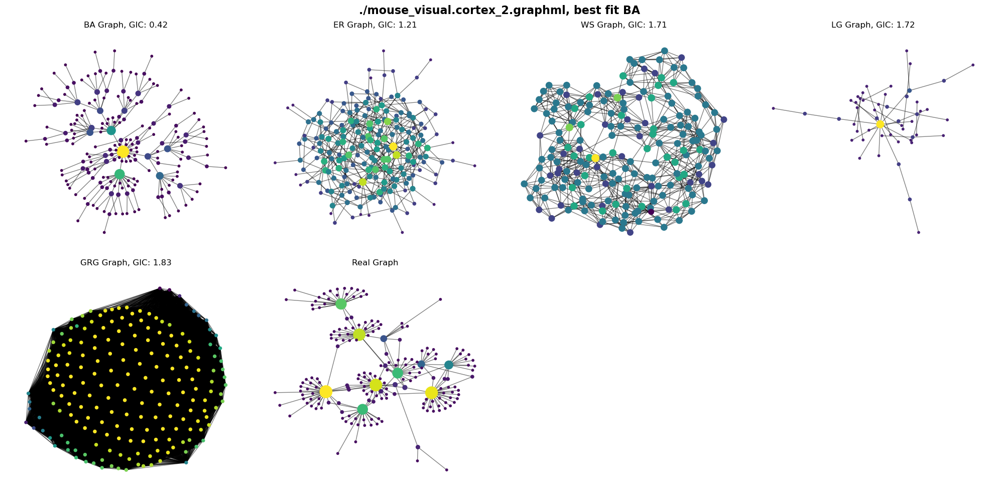

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.235     
Date:               2024-07-11 21:05 AIC:              95369.1270
No. Observations:   126262           BIC:              95398.3653
Df Model:           2                Log-Likelihood:   -47682.   
Df Residuals:       126259           LL-Null:          -62346.   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     17.0000          Scale:            1.0000    
-------------------------------------------------------------------
         Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const   -3.4610     0.0197   -175.8804   0.0000   -3.4996   -3.4225
x1       0.0099     0.0001     83.2883   0.0000    0.0097    0.0102
x2       0.0087     0.0001     81.4852   0.0000    0.0085    0.0089

iteration: 0
iteration:

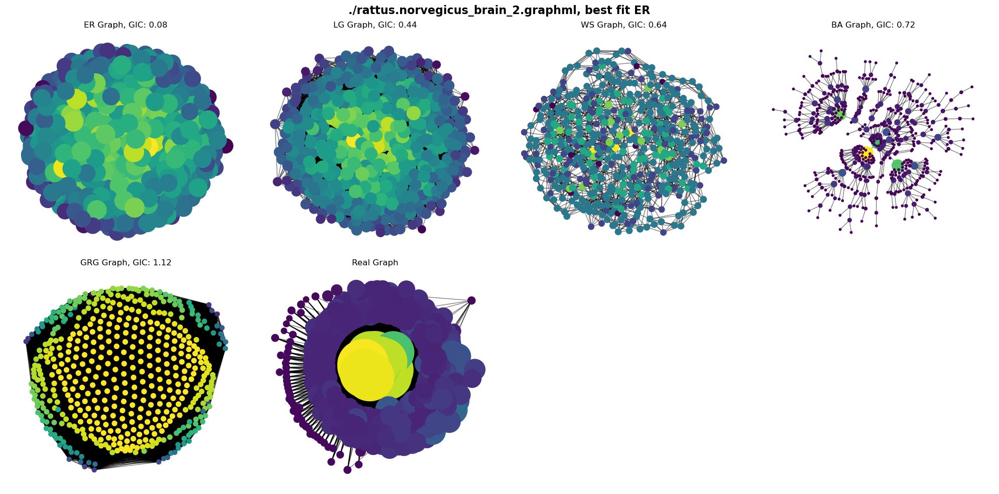

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.155     
Date:               2024-07-11 21:08 AIC:              784.4641  
No. Observations:   1431             BIC:              800.2625  
Df Model:           2                Log-Likelihood:   -389.23   
Df Residuals:       1428             LL-Null:          -460.56   
Converged:          1.0000           LLR p-value:      1.0511e-31
No. Iterations:     13.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -3.1260     0.1392   -22.4559   0.0000   -3.3988   -2.8531
x1        0.0298     0.0031     9.5103   0.0000    0.0237    0.0360
x2        0.0466     0.0075     6.1941   0.0000    0.0318    0.0613

iteration: 0
iteration:

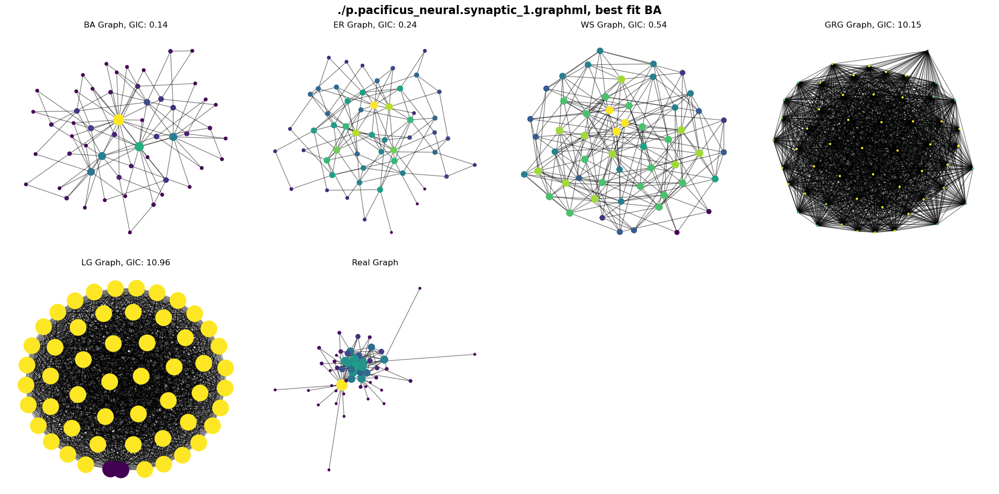

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.117     
Date:               2024-07-11 21:08 AIC:              251.9297  
No. Observations:   406              BIC:              263.9487  
Df Model:           2                Log-Likelihood:   -122.96   
Df Residuals:       403              LL-Null:          -139.30   
Converged:          1.0000           LLR p-value:      8.0501e-08
No. Iterations:     11.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -2.8726     0.2482   -11.5724   0.0000   -3.3591   -2.3861
x1        0.1373     0.0239     5.7423   0.0000    0.0904    0.1842
x2       -0.0021     0.0432    -0.0489   0.9610   -0.0867    0.0825

iteration: 0
iteration:

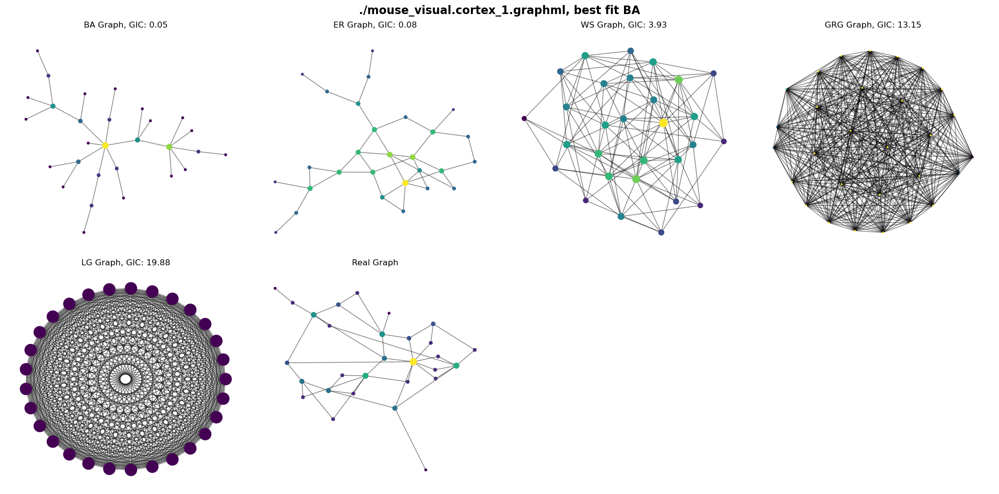

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.247     
Date:               2024-07-11 21:08 AIC:              95393.9940
No. Observations:   122769           BIC:              95423.1481
Df Model:           2                Log-Likelihood:   -47694.   
Df Residuals:       122766           LL-Null:          -63371.   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     16.0000          Scale:            1.0000    
-------------------------------------------------------------------
         Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const   -3.5358     0.0194   -182.4247   0.0000   -3.5737   -3.4978
x1       0.0073     0.0001    100.4483   0.0000    0.0072    0.0075
x2       0.0093     0.0001     89.2948   0.0000    0.0091    0.0095

iteration: 0
iteration:

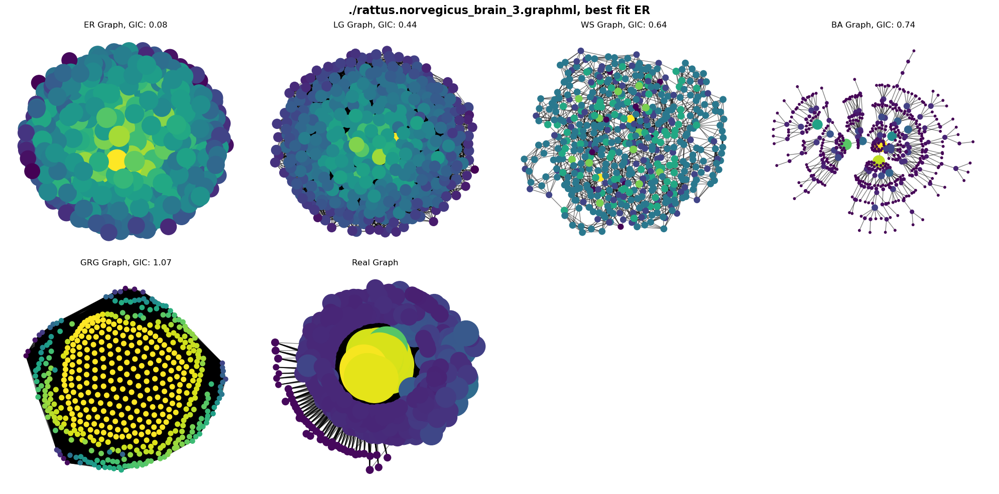

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.006     
Date:               2024-07-11 21:12 AIC:              5889.5306 
No. Observations:   4278             BIC:              5908.6144 
Df Model:           2                Log-Likelihood:   -2941.8   
Df Residuals:       4275             LL-Null:          -2958.2   
Converged:          1.0000           LLR p-value:      7.2369e-08
No. Iterations:     13.0000          Scale:            1.0000    
-------------------------------------------------------------------
           Coef.    Std.Err.      z      P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const     -1.2662     0.3911   -3.2379   0.0012   -2.0327   -0.4998
x1        -0.0003     0.0003   -0.9824   0.3259   -0.0010    0.0003
x2         0.0022     0.0004    5.6258   0.0000    0.0014    0.0030

iteration: 0
iteration:

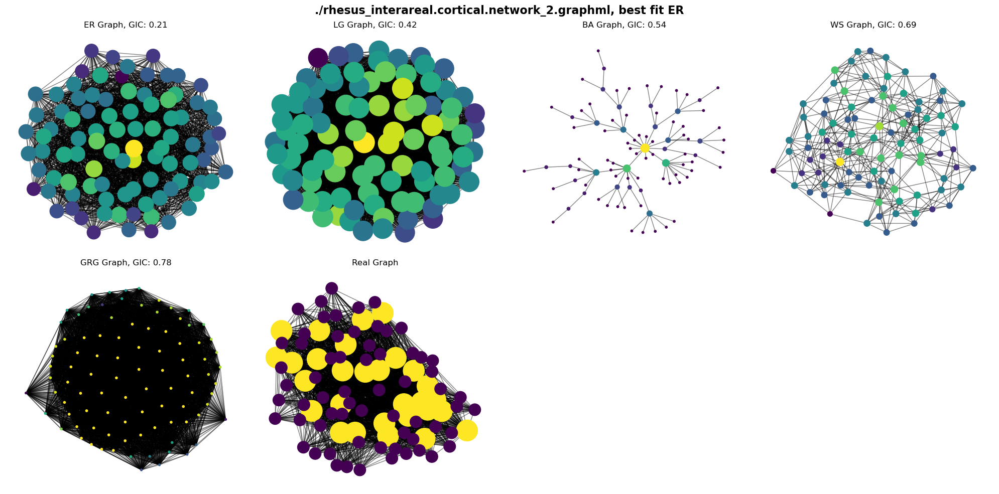

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.125     
Date:               2024-07-11 21:12 AIC:              17122.5456
No. Observations:   29161            BIC:              17147.3873
Df Model:           2                Log-Likelihood:   -8558.3   
Df Residuals:       29158            LL-Null:          -9779.2   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     15.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -4.0185     0.0498   -80.6551   0.0000   -4.1161   -3.9208
x1        0.0513     0.0013    39.4490   0.0000    0.0487    0.0538
x2        0.0408     0.0014    29.7214   0.0000    0.0382    0.0435

iteration: 0
iteration:

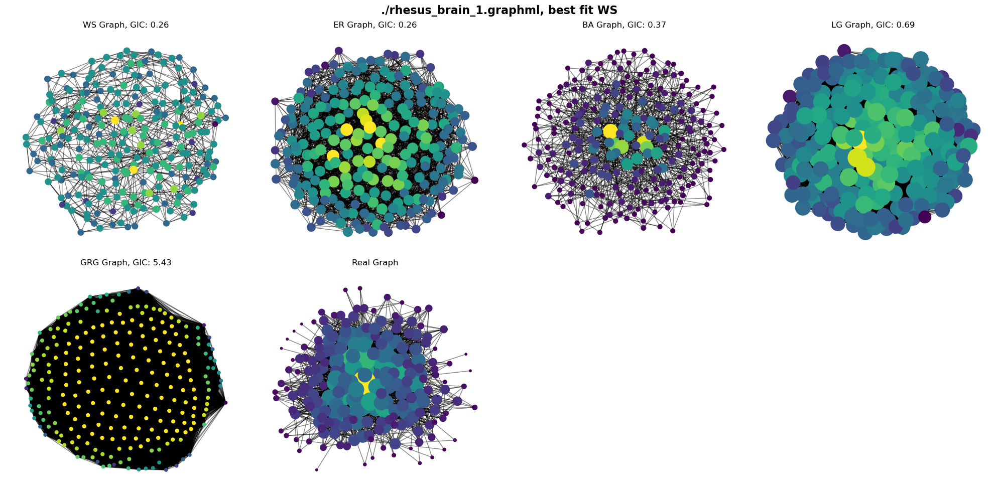

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                          Results: Logit
Model:              Logit            Method:           MLE        
Dependent Variable: y                Pseudo R-squared: 0.147      
Date:               2024-07-11 21:13 AIC:              443127.5623
No. Observations:   630003           BIC:              443161.6228
Df Model:           2                Log-Likelihood:   -2.2156e+05
Df Residuals:       630000           LL-Null:          -2.5982e+05
Converged:          1.0000           LLR p-value:      0.0000     
No. Iterations:     14.0000          Scale:            1.0000     
--------------------------------------------------------------------
          Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
--------------------------------------------------------------------
const    -2.7324     0.0060   -455.0805   0.0000   -2.7441   -2.7206
x1        0.0006     0.0000    168.7557   0.0000    0.0006    0.0006
x2        0.0013     0.0000    169.6182   0.0000    0.0012    0.0013

iteratio

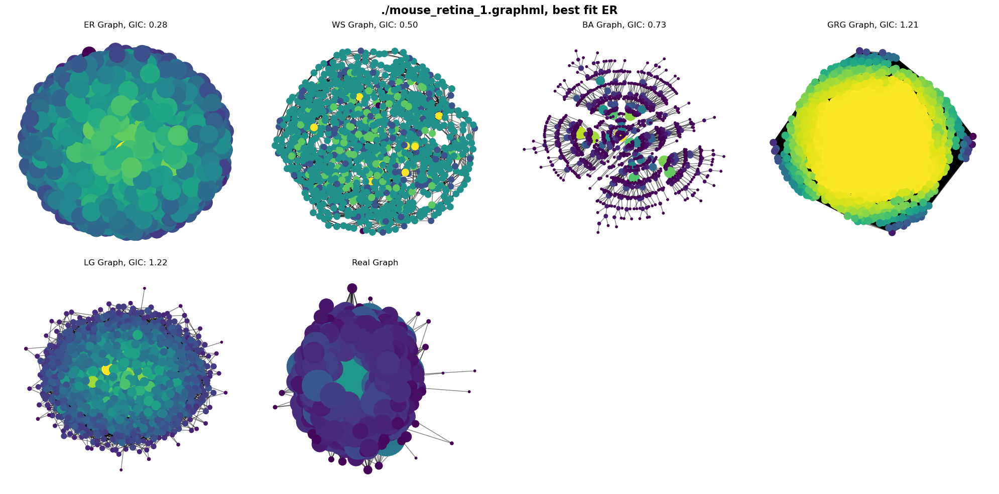

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.100     
Date:               2024-07-11 21:33 AIC:              19148.9930
No. Observations:   528906           BIC:              19182.5287
Df Model:           2                Log-Likelihood:   -9571.5   
Df Residuals:       528903           LL-Null:          -10641.   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     30.0000          Scale:            1.0000    
-------------------------------------------------------------------
         Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const   -6.1575     0.0293   -209.8312   0.0000   -6.2150   -6.0999
x1       0.0322     0.0005     64.4056   0.0000    0.0312    0.0331
x2       0.0311     0.0031      9.8716   0.0000    0.0249    0.0372

iteration: 0
iteration:

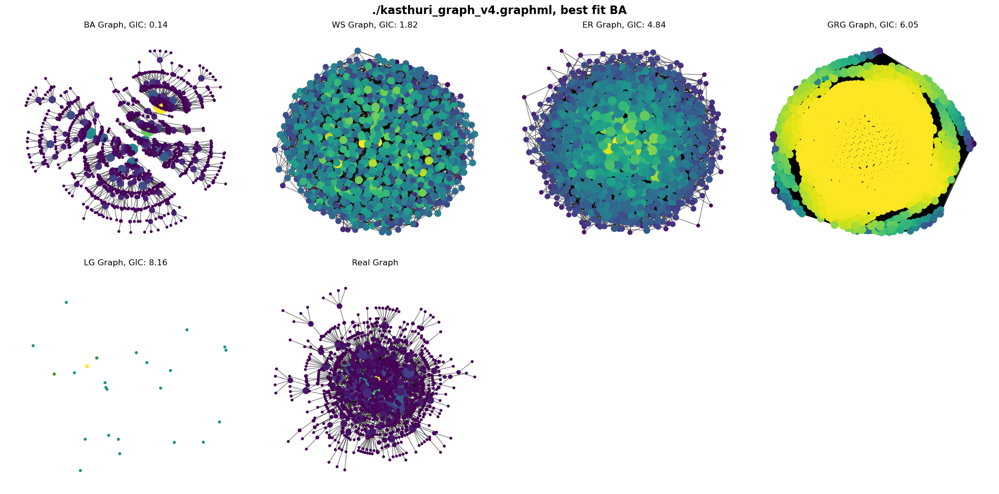

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.103     
Date:               2024-07-11 21:46 AIC:              24397.0716
No. Observations:   22731            BIC:              24421.1660
Df Model:           2                Log-Likelihood:   -12196.   
Df Residuals:       22728            LL-Null:          -13594.   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     15.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -1.8538     0.0570   -32.5221   0.0000   -1.9656   -1.7421
x1        0.0143     0.0004    35.9305   0.0000    0.0135    0.0151
x2        0.0142     0.0004    36.4636   0.0000    0.0134    0.0149

iteration: 0
iteration:

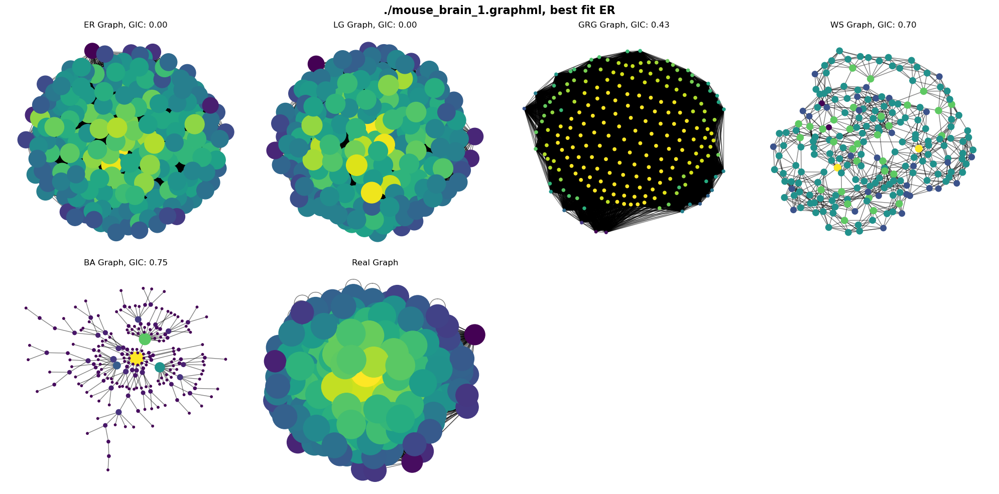

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                          Results: Logit
Model:              Logit            Method:           MLE        
Dependent Variable: y                Pseudo R-squared: 0.078      
Date:               2024-07-11 21:47 AIC:              102513.9458
No. Observations:   1585195          BIC:              102550.7745
Df Model:           2                Log-Likelihood:   -51254.    
Df Residuals:       1585192          LL-Null:          -55598.    
Converged:          1.0000           LLR p-value:      0.0000     
No. Iterations:     25.0000          Scale:            1.0000     
--------------------------------------------------------------------
          Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
--------------------------------------------------------------------
const    -5.6000     0.0127   -440.9338   0.0000   -5.6249   -5.5751
x1        0.0049     0.0001     97.2226   0.0000    0.0048    0.0050
x2        0.0093     0.0001     64.7099   0.0000    0.0090    0.0096

iteratio

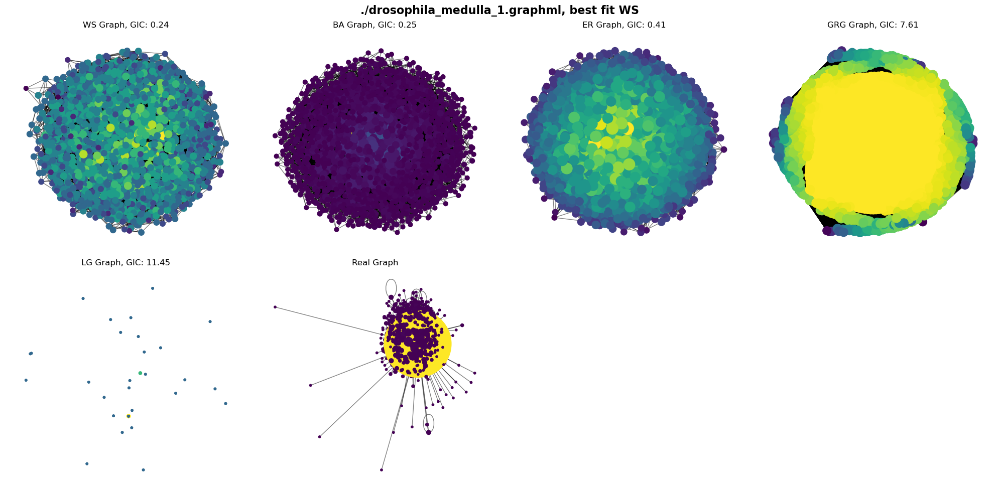

/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2385: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-X))
/Users/maruanottoni/miniforge3/envs/gt/lib/python3.12/site-packages/statsmodels/discrete/discrete_model.py:2443: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q * linpred)))


                          Results: Logit
Model:              Logit            Method:           MLE        
Dependent Variable: y                Pseudo R-squared: 0.055      
Date:               2024-07-11 22:37 AIC:              16457.1918 
No. Observations:   38784            BIC:              16482.8891 
Df Model:           2                Log-Likelihood:   -8225.6    
Df Residuals:       38781            LL-Null:          -8700.5    
Converged:          1.0000           LLR p-value:      5.7814e-207
No. Iterations:     15.0000          Scale:            1.0000     
--------------------------------------------------------------------
           Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
--------------------------------------------------------------------
const     -3.5394     0.0355   -99.7305   0.0000   -3.6089   -3.4698
x1         0.0128     0.0005    28.3990   0.0000    0.0119    0.0137
x2         0.0141     0.0007    19.0530   0.0000    0.0127    0.0156

iteratio

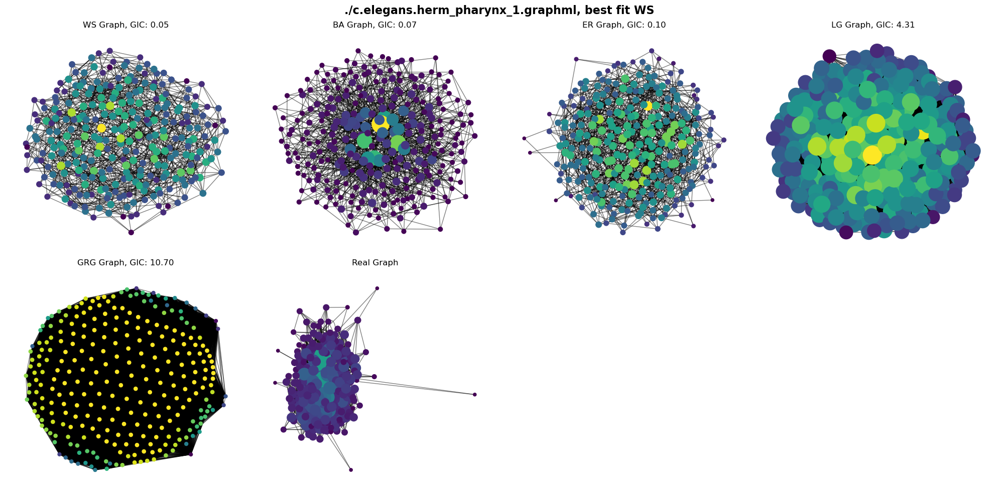

                          Results: Logit
Model:              Logit            Method:           MLE        
Dependent Variable: y                Pseudo R-squared: 0.150      
Date:               2024-07-11 22:38 AIC:              2853.3877  
No. Observations:   4095             BIC:              2872.3403  
Df Model:           2                Log-Likelihood:   -1423.7    
Df Residuals:       4092             LL-Null:          -1674.0    
Converged:          1.0000           LLR p-value:      1.8844e-109
No. Iterations:     16.0000          Scale:            1.0000     
--------------------------------------------------------------------
           Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
--------------------------------------------------------------------
const     -5.3957     0.2319   -23.2718   0.0000   -5.8502   -4.9413
x1         0.1465     0.0207     7.0691   0.0000    0.1059    0.1871
x2         0.3505     0.0190    18.4363   0.0000    0.3132    0.3878

iteratio

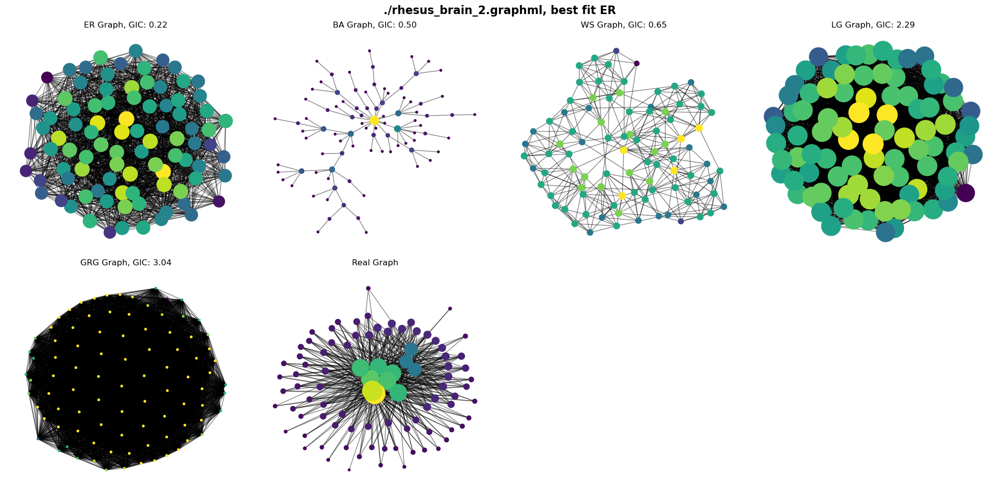

                         Results: Logit
Model:              Logit            Method:           MLE       
Dependent Variable: y                Pseudo R-squared: 0.148     
Date:               2024-07-11 22:38 AIC:              17597.3064
No. Observations:   36919            BIC:              17622.8559
Df Model:           2                Log-Likelihood:   -8795.7   
Df Residuals:       36916            LL-Null:          -10320.   
Converged:          1.0000           LLR p-value:      0.0000    
No. Iterations:     15.0000          Scale:            1.0000    
-------------------------------------------------------------------
          Coef.    Std.Err.      z       P>|z|     [0.025    0.975]
-------------------------------------------------------------------
const    -4.5287     0.0552   -82.0133   0.0000   -4.6369   -4.4205
x1        0.0559     0.0012    46.4901   0.0000    0.0536    0.0583
x2        0.0465     0.0016    29.4004   0.0000    0.0434    0.0496

iteration: 0
iteration:

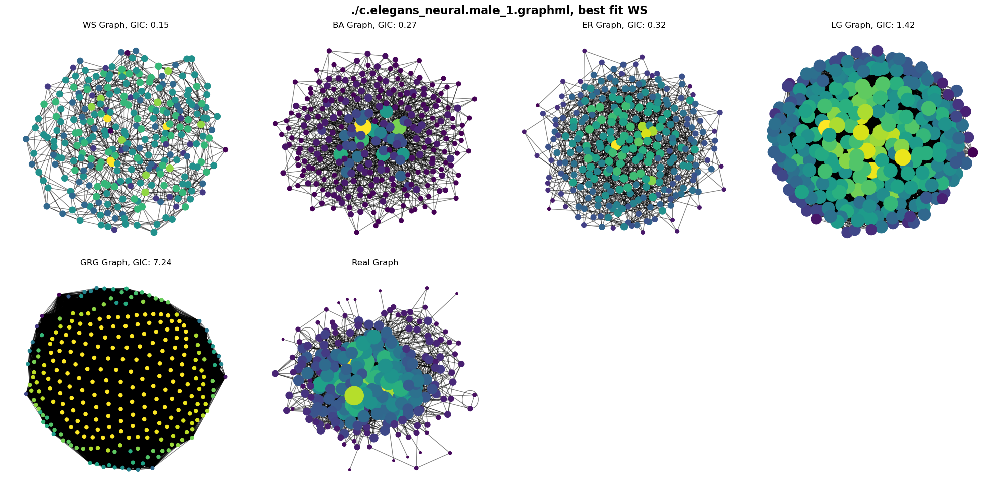

In [170]:
for i in range(len(connectomes)):
   real_graph = nx.read_graphml(datasets + connectomes[i])
   real_graph = nx.to_numpy_array(real_graph)
   logit_graph, sigma = get_logit_graph(real_graph=real_graph, d=0) # TODO: Improve the estimation of d
   #logit_graph = nx.to_numpy_array(logit_graph)

   selector = ms.GraphModelSelection(graph=nx.from_numpy_array(real_graph),
                                    log_graph=nx.from_numpy_array(logit_graph),
                                    log_params=sigma,
                                    #models=["ER", "WS", "GRG", "BA", "KR", "LG"],
                                    models=["ER", "WS", "GRG", "BA", "LG"],
                                    parameters=[ {'lo': 0.01, 'hi': 1}, # ER
                                                {'lo': 0.01, 'hi': 1}, # WS k=8
                                                {'lo': 1, 'hi': 3},    # GRG
                                                {'lo': 1, 'hi': 5},    # BA
                                                #{'lo': 1, 'hi': 3},    # KR
                                             ]
                                    )

   result = selector.select_model()
   result_dict = {item['model']: {'param': clean_and_convert(item['param']), 'GIC': item['GIC']} for item in result['estimates']}
   min_gic_key = min(result_dict, key=lambda k: result_dict[k]['GIC']) # Get best fit
   model_names = result_dict.keys() 

   sim_graphs_dict = {}
   for model in model_names:
      if model!='LG':
         func = selector.model_function(model_name=model)
         graph_sim = func(real_graph.shape[0], float(result_dict[model]['param']))
         sim_graphs_dict[model] = graph_sim
      elif model=='LG':
         sim_graphs_dict[model] = nx.from_numpy_array(logit_graph)

   sim_graphs_dict['Real'] = nx.from_numpy_array(real_graph)
   fig = plot_graphs_in_matrix(sim_graphs_dict,
                               result_dict,
                               global_title=f'./{connectomes[i]}, best fit {min_gic_key}',
                               save_path=f'./imgs_connectomes/{connectomes[i]}.png')